# Exploratory Data Analysis Starter

## Import packages

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
#!pip install pandas_profiling
from pandas_profiling import ProfileReport


# Shows plots in jupyter notebook
%matplotlib inline

# Set plot style
sns.set(color_codes=True)

<ipython-input-1-f597a8edf3db>:5: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


## Sub task 1

---

## Loading data with Pandas

We need to load `client_data.csv` and `price_data.csv` into individual dataframes so that we can work with them in Python. For this notebook and all further notebooks, it will be assumed that the CSV files will the placed in the same file location as the notebook. If they are not, please adjust the directory within the `read_csv` method accordingly.

In [2]:
client_df = pd.read_csv('/content/client_data.csv')
price_df = pd.read_csv('/content/price_data.csv')

You can view the first 3 rows of a dataframe using the `head` method. Similarly, if you wanted to see the last 3, you can use `tail(3)`

In [3]:
client_df.head(3)

,id,channel_sales,cons_12m,cons_gas_12m,cons_last_month,date_activ,date_end,date_modif_prod,date_renewal,forecast_cons_12m,...,has_gas,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,origin_up,pow_max,churn
0,24011ae4ebbe3035111d65fa7c15bc57,foosdfpfkusacimwkcsosbicdxkicaua,0,54946,0,2013-06-15,2016-06-15,2015-11-01,2015-06-23,0.00,...,t,0.0,25.44,25.44,2,678.99,3,lxidpiddsbxsbosboudacockeimpuepw,43.648,1
1,d29c2c54acc38ff3c0614d0a653813dd,MISSING,4660,0,0,2009-08-21,2016-08-30,2009-08-21,2015-08-31,189.95,...,f,0.0,16.38,16.38,1,18.89,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.800,0
2,764c75f661154dac3a6c254cd082ea7d,foosdfpfkusacimwkcsosbicdxkicaua,544,0,0,2010-04-16,2016-04-16,2010-04-16,2015-04-17,47.96,...,f,0.0,28.60,28.60,1,6.60,6,kamkkxfxxuwbdslkwifmmcsiusiuosws,13.856,0


In [4]:
price_df.head(3)

,id,price_date,price_off_peak_var,price_peak_var,price_mid_peak_var,price_off_peak_fix,price_peak_fix,price_mid_peak_fix
0,038af19179925da21a25619c5a24b745,2015-01-01,0.151367,0.0,0.0,44.266931,0.0,0.0
1,038af19179925da21a25619c5a24b745,2015-02-01,0.151367,0.0,0.0,44.266931,0.0,0.0
2,038af19179925da21a25619c5a24b745,2015-03-01,0.151367,0.0,0.0,44.266931,0.0,0.0


---

## Descriptive statistics of data

### Data types

It is useful to first understand the data that you're dealing with along with the data types of each column. The data types may dictate how you transform and engineer features.

To get an overview of the data types within a data frame, use the `info()` method.

In [5]:
client_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14606 entries, 0 to 14605
Data columns (total 26 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              14606 non-null  object 
 1   channel_sales                   14606 non-null  object 
 2   cons_12m                        14606 non-null  int64  
 3   cons_gas_12m                    14606 non-null  int64  
 4   cons_last_month                 14606 non-null  int64  
 5   date_activ                      14606 non-null  object 
 6   date_end                        14606 non-null  object 
 7   date_modif_prod                 14606 non-null  object 
 8   date_renewal                    14606 non-null  object 
 9   forecast_cons_12m               14606 non-null  float64
 10  forecast_cons_year              14606 non-null  int64  
 11  forecast_discount_energy        14606 non-null  float64
 12  forecast_meter_rent_12m         

In [6]:
price_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 193002 entries, 0 to 193001
Data columns (total 8 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   id                  193002 non-null  object 
 1   price_date          193002 non-null  object 
 2   price_off_peak_var  193002 non-null  float64
 3   price_peak_var      193002 non-null  float64
 4   price_mid_peak_var  193002 non-null  float64
 5   price_off_peak_fix  193002 non-null  float64
 6   price_peak_fix      193002 non-null  float64
 7   price_mid_peak_fix  193002 non-null  float64
dtypes: float64(6), object(2)
memory usage: 11.8+ MB


### Statistics

Now let's look at some statistics about the datasets. We can do this by using the `describe()` method.

In [7]:
client_df.describe()

,cons_12m,cons_gas_12m,cons_last_month,forecast_cons_12m,forecast_cons_year,forecast_discount_energy,forecast_meter_rent_12m,forecast_price_energy_off_peak,forecast_price_energy_peak,forecast_price_pow_off_peak,imp_cons,margin_gross_pow_ele,margin_net_pow_ele,nb_prod_act,net_margin,num_years_antig,pow_max,churn
count,1.460600e+04,1.460600e+04,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000,14606.000000
mean,1.592203e+05,2.809238e+04,16090.269752,1868.614880,1399.762906,0.966726,63.086871,0.137283,0.050491,43.130056,152.786896,24.565121,24.562517,1.292346,189.264522,4.997809,18.135136,0.097152
std,5.734653e+05,1.629731e+05,64364.196422,2387.571531,3247.786255,5.108289,66.165783,0.024623,0.049037,4.485988,341.369366,20.231172,20.230280,0.709774,311.798130,1.611749,13.534743,0.296175
min,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,3.300000,0.000000
25%,5.674750e+03,0.000000e+00,0.000000,494.995000,0.000000,0.000000,16.180000,0.116340,0.000000,40.606701,0.000000,14.280000,14.280000,1.000000,50.712500,4.000000,12.500000,0.000000
50%,1.411550e+04,0.000000e+00,792.500000,1112.875000,314.000000,0.000000,18.795000,0.143166,0.084138,44.311378,37.395000,21.640000,21.640000,1.000000,112.530000,5.000000,13.856000,0.000000
75%,4.076375e+04,0.000000e+00,3383.000000,2401.790000,1745.750000,0.000000,131.030000,0.146348,0.098837,44.311378,193.980000,29.880000,29.880000,1.000000,243.097500,6.000000,19.172500,0.000000
max,6.207104e+06,4.154590e+06,771203.000000,82902.830000,175375.000000,30.000000,599.310000,0.273963,0.195975,59.266378,15042.790000,374.640000,374.640000,32.000000,24570.650000,13.000000,320.000000,1.000000


In [8]:
price_df.describe()

,price_off_peak_var,price_peak_var,price_mid_peak_var,price_off_peak_fix,price_peak_fix,price_mid_peak_fix
count,193002.000000,193002.000000,193002.000000,193002.000000,193002.000000,193002.000000
mean,0.141027,0.054630,0.030496,43.334477,10.622875,6.409984
std,0.025032,0.049924,0.036298,5.410297,12.841895,7.773592
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.125976,0.000000,0.000000,40.728885,0.000000,0.000000
50%,0.146033,0.085483,0.000000,44.266930,0.000000,0.000000
75%,0.151635,0.101673,0.072558,44.444710,24.339581,16.226389
max,0.280700,0.229788,0.114102,59.444710,36.490692,17.458221


In [9]:
price_df.duplicated().sum()
client_df.duplicated().sum()

0

## **Exploratory data analysis**
-  ### client's data frame



In [10]:
profile = ProfileReport(client_df, title='Pandas Profiling Report', explorative=True)#using pandas profiling to get an exhaustive report of the dataset
profile.to_notebook_iframe()#viewing the report in the notebook


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

price dataframe

In [11]:
profile = ProfileReport(price_df, title='Pandas Profiling Report', explorative=True)#using pandas profiling to get an exhaustive report of the dataset
profile.to_notebook_iframe()#viewing the report in the notebook

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

---

## Data visualization

If you're working in Python, two of the most popular packages for visualization are `matplotlib` and `seaborn`. We highly recommend you use these, or at least be familiar with them because they are ubiquitous!

Below are some functions that you can use to get started with visualizations.

In [12]:
def plot_stacked_bars(dataframe, title_, size_=(18, 10), rot_=0, legend_="upper right"):
    """
    Plot stacked bars with annotations
    """
    ax = dataframe.plot(
        kind="bar",
        stacked=True,
        figsize=size_,
        rot=rot_,
        title=title_
    )

    # Annotate bars
    annotate_stacked_bars(ax, textsize=14)
    # Rename legend
    plt.legend(["Retention", "Churn"], loc=legend_)
    # Labels
    plt.ylabel("Company base (%)")
    plt.show()

def annotate_stacked_bars(ax, pad=0.99, colour="white", textsize=13):
    """
    Add value annotations to the bars
    """

    # Iterate over the plotted rectanges/bars
    for p in ax.patches:

        # Calculate annotation
        value = str(round(p.get_height(),1))
        # If value is 0 do not annotate
        if value == '0.0':
            continue
        ax.annotate(
            value,
            ((p.get_x()+ p.get_width()/2)*pad-0.05, (p.get_y()+p.get_height()/2)*pad),
            color=colour,
            size=textsize
        )

def plot_distribution(dataframe, column, ax, bins_=50):
    """
    Plot variable distirbution in a stacked histogram of churned or retained company
    """
    # Create a temporal dataframe with the data to be plot
    temp = pd.DataFrame({"Retention": dataframe[dataframe["churn"]==0][column],
    "Churn":dataframe[dataframe["churn"]==1][column]})
    # Plot the histogram
    temp[["Retention","Churn"]].plot(kind='hist', bins=bins_, ax=ax, stacked=True)
    # X-axis label
    ax.set_xlabel(column)
    # Change the x-axis to plain style
    ax.ticklabel_format(style='plain', axis='x')

Thhe first function `plot_stacked_bars` is used to plot a stacked bar chart. An example of how you could use this is shown below:

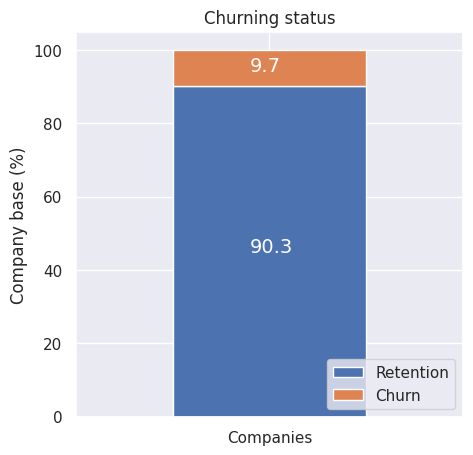

In [13]:
churn = client_df[['id', 'churn']]
churn.columns = ['Companies', 'churn']
churn_total = churn.groupby(churn['churn']).count()
churn_percentage = churn_total / churn_total.sum() * 100
plot_stacked_bars(churn_percentage.transpose(), "Churning status", (5, 5), legend_="lower right")

The second function `annotate_bars` is used by the first function, but the third function `plot_distribution` helps you to plot the distribution of a numeric column. An example of how it can be used is given below:

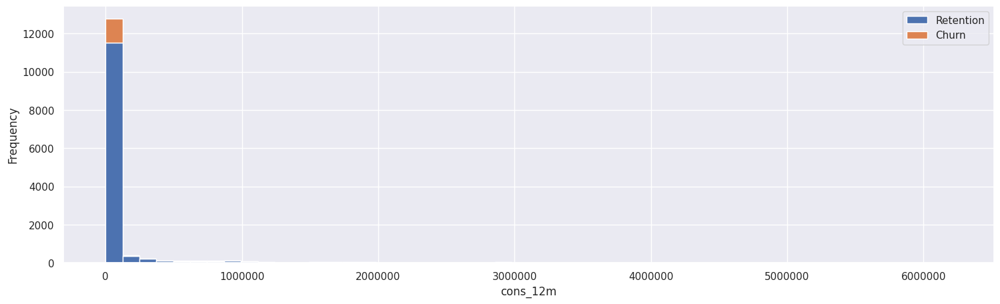

In [14]:
consumption = client_df[['id', 'cons_12m', 'cons_gas_12m', 'cons_last_month', 'imp_cons', 'has_gas', 'churn']]

fig, axs = plt.subplots(nrows=1, figsize=(18, 5))

plot_distribution(consumption, 'cons_12m', axs)

## Sub task 2

In [15]:
price_df.columns

Index(['id', 'price_date', 'price_off_peak_var', 'price_peak_var',
       'price_mid_peak_var', 'price_off_peak_fix', 'price_peak_fix',
       'price_mid_peak_fix'],
      dtype='object')

In [16]:
#defining price sensitivity
price_df['price_sensitivity_off_peak_var'] = (price_df['price_peak_var'] - price_df['price_off_peak_var']) / price_df['price_off_peak_var'] * 100
price_df['price_sensitivity_peak_var'] = (price_df['price_mid_peak_var'] - price_df['price_peak_var']) / price_df['price_peak_var'] * 100
price_df['price_sensitivity_off_peak_fix'] = (price_df['price_peak_fix'] - price_df['price_off_peak_fix']) / price_df['price_off_peak_fix'] * 100
price_df['price_sensitivity_peak_fix'] = (price_df['price_mid_peak_fix'] - price_df['price_peak_fix']) / price_df['price_peak_fix'] * 100



In [17]:
#merging the two dataframes
merged_df = client_df.merge(price_df, on='id', how='inner')
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 175149 entries, 0 to 175148
Data columns (total 37 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              175149 non-null  object 
 1   channel_sales                   175149 non-null  object 
 2   cons_12m                        175149 non-null  int64  
 3   cons_gas_12m                    175149 non-null  int64  
 4   cons_last_month                 175149 non-null  int64  
 5   date_activ                      175149 non-null  object 
 6   date_end                        175149 non-null  object 
 7   date_modif_prod                 175149 non-null  object 
 8   date_renewal                    175149 non-null  object 
 9   forecast_cons_12m               175149 non-null  float64
 10  forecast_cons_year              175149 non-null  int64  
 11  forecast_discount_energy        175149 non-null  float64
 12  forecast_meter_r

In [18]:
missing_data = merged_df.isnull().sum()
missing_percentage = (missing_data / len(merged_df)) * 100
missing_percentage

id                                 0.000000
channel_sales                      0.000000
cons_12m                           0.000000
cons_gas_12m                       0.000000
cons_last_month                    0.000000
date_activ                         0.000000
date_end                           0.000000
date_modif_prod                    0.000000
date_renewal                       0.000000
forecast_cons_12m                  0.000000
forecast_cons_year                 0.000000
forecast_discount_energy           0.000000
forecast_meter_rent_12m            0.000000
forecast_price_energy_off_peak     0.000000
forecast_price_energy_peak         0.000000
forecast_price_pow_off_peak        0.000000
has_gas                            0.000000
imp_cons                           0.000000
margin_gross_pow_ele               0.000000
margin_net_pow_ele                 0.000000
nb_prod_act                        0.000000
net_margin                         0.000000
num_years_antig                 

In [19]:
'''
The price sensitivity peak var and peak fix columns have alot of missing values.
imputing the missing values might lead to false findings.

'''
merged_df.drop(['price_sensitivity_peak_var', 'price_sensitivity_peak_fix'], axis=1, inplace=True)


In [20]:
'''
the other columns with missing values have less than 1% missing values thus we can impute them.
we'll impute them using the median since imputing with the mean might skew the data
'''
def impute_missing_values(df, columns_to_impute):
    """
    Impute missing values in the specified columns with their respective medians.

    Parameters:
        df (DataFrame): The DataFrame containing the columns to impute.
        columns_to_impute (list): A list of column names to impute.

    Returns:
        DataFrame: The DataFrame with missing values imputed.
    """
    for column in columns_to_impute:
        median_value = df[column].median()
        df[column].fillna(median_value, inplace=True)

    return df

# List of columns to impute
columns_to_impute = [
    'price_sensitivity_off_peak_var',
    'price_sensitivity_off_peak_fix']

# Call the function to impute missing values
merged_df = impute_missing_values(merged_df, columns_to_impute)



In [21]:
missing_data = merged_df.isnull().sum()
missing_percentage = (missing_data / len(merged_df)) * 100
missing_percentage

id                                0.0
channel_sales                     0.0
cons_12m                          0.0
cons_gas_12m                      0.0
cons_last_month                   0.0
date_activ                        0.0
date_end                          0.0
date_modif_prod                   0.0
date_renewal                      0.0
forecast_cons_12m                 0.0
forecast_cons_year                0.0
forecast_discount_energy          0.0
forecast_meter_rent_12m           0.0
forecast_price_energy_off_peak    0.0
forecast_price_energy_peak        0.0
forecast_price_pow_off_peak       0.0
has_gas                           0.0
imp_cons                          0.0
margin_gross_pow_ele              0.0
margin_net_pow_ele                0.0
nb_prod_act                       0.0
net_margin                        0.0
num_years_antig                   0.0
origin_up                         0.0
pow_max                           0.0
churn                             0.0
price_date  

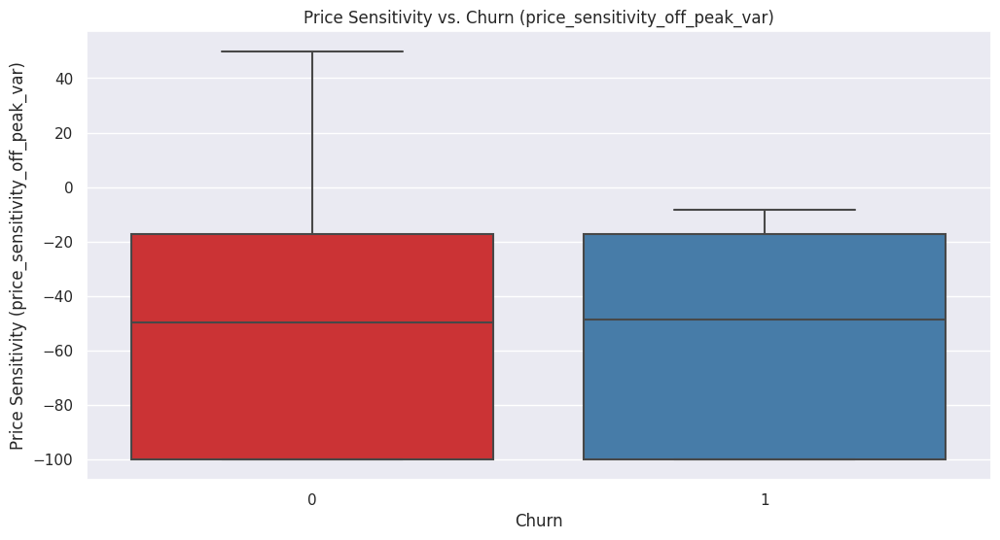

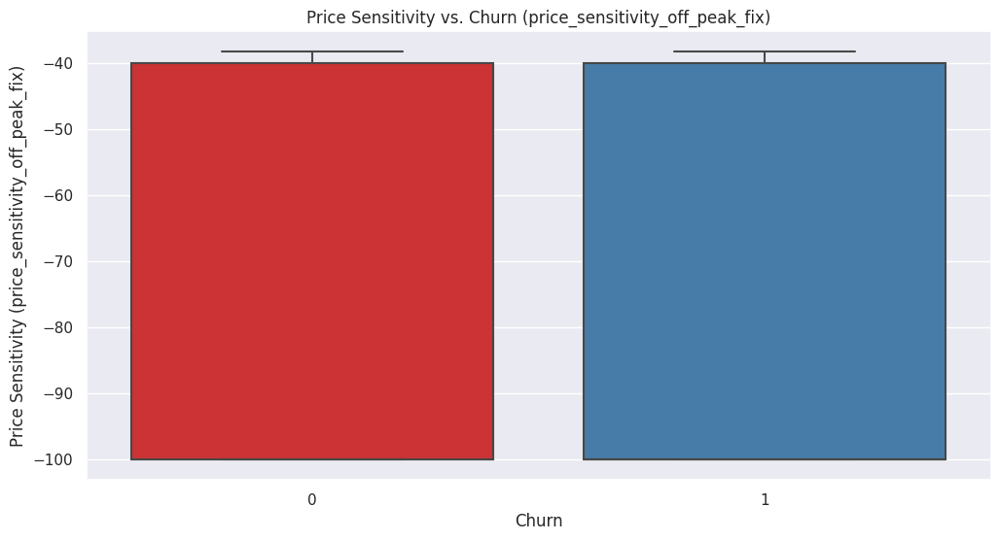

In [22]:
col=['price_sensitivity_off_peak_var' , 'price_sensitivity_off_peak_fix']


def plot_price_sensitivity_boxplot(data, column_name):
    """
    Generate a box plot to compare price sensitivity against churn for a specific column.

    Parameters:
        data (DataFrame): The DataFrame containing price sensitivity and churn columns.
        column_name (str): The name of the price sensitivity column to analyze.
    """
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=data, x='churn', y=column_name, palette='Set1')
    plt.xlabel('Churn')
    plt.ylabel(f'Price Sensitivity ({column_name})')
    plt.title(f'Price Sensitivity vs. Churn ({column_name})')
    plt.show()

for column in col:
  plot_price_sensitivity_boxplot(merged_df, column)



**Price Sensitivity vs. Churn for Energy:**
- **Median Comparison:** The medians of the two groups (churned and retained customers) are approximately equal. This suggests that, on average, there is no significant difference in price sensitivity for energy between the two groups.

- **Box Height (IQR):** Both boxes have a moderate height, which indicates that the interquartile range (IQR) and the spread of price sensitivity values are similar for both churned and retained customers. The moderate height suggests that there is a moderate level of variability in price sensitivity in both groups.

- **Upper Whiskers:** The upper whisker for the retained customers is longer than that of the churned customers. This means that there are more potential outliers (values significantly higher than the upper quartile) among retained customers. It suggests that a subset of retained customers may have extreme price sensitivity for energy.

**Price Sensitivity vs. Churn for Power:**
- **Median Comparison:** Similar to the energy analysis, the medians of the two groups for power are approximately equal. This indicates that, on average, there is no significant difference in price sensitivity for power between churned and retained customers.

- **Box Height (IQR):** Both boxes are tall, which means that the interquartile range (IQR) and the spread of price sensitivity values are similar and relatively large for both churned and retained customers. The tall boxes suggest that there is a substantial variability in price sensitivity for power in both groups.

- **Upper Whiskers:** Both churned and retained customers have short upper whiskers, indicating that there are fewer potential outliers among both groups. This suggests that extreme price sensitivity values for power are less common in both groups compared to energy.

Overall, the findings indicate that, on average, there is no significant difference in price sensitivity between churned and retained customers for both energy and power. However, there is variability in price sensitivity within both groups, with the possibility of some outliers, particularly among retained customers. Further statistical tests may be necessary to confirm the significance of these observations.
